<div style="background-color: #121212; padding: 10px;">
<img src="Images/header.png" alt="jum2digital" style="max-width:100%;">
</div>

<div style="background-color: #F5F5F5; padding: 20px; border: 1px solid #CCCCCC;">

### Project Description

This analysis centers on multiple datasets pertaining to Barcelona. Each dataset provides insights into distinct facets of the city—ranging from housing costs to environmental factors and public safety.

#### Datasets:

1. **Barcelona Rent**:
    - **Description**: Data about the average monthly rent (€/month) and by surface area (€/m2) in the city of Barcelona for the year 2017.
    - **Source**: [Open Data Barcelona](https://opendata-ajuntament.barcelona.cat/data/es/dataset/est-mercat-immobiliari-lloguer-mitja-mensual/resource/0a71a12d-55fa-4a76-b816-4ee55f84d327)
    - **File**: `2017_Alquiler_precio_trim.csv`

    
2. **Noise Exposure**:
    - **Description**: Information about the population's exposure to noise levels from the Strategic Noise Map of Barcelona.
    - **Source**: [Open Data Barcelona](https://opendata-ajuntament.barcelona.cat/data/es/dataset/poblacio-exposada-mapa-estrategic-soroll/resource/3846500e-72aa-4780-967f-f09aa184eaba)
    - **File**: `2017_Poblacio_exposada_barris_Mapa_Estrategic_Soroll_BCN_LONG.csv`

    
3. **Traffic Accidents**:
    - **Description**: Data about traffic accidents managed by the Urban Guard in Barcelona.
    - **Source**: [Open Data Barcelona](https://opendata-ajuntament.barcelona.cat/data/ca/dataset/accidents_causa_conductor_gu_bcn/resource/1a05cdd4-4844-41a5-872d-a0824d11b517?inner_span=True)
    - **File**: `2017_ACCIDENTS_CAUSA_CONDUCTOR_GU_BCN_.csv`

The objective of this analysis is to comprehensively evaluate these datasets to elucidate the socioeconomic and environmental dynamics shaping Barcelona.

</div>



<div style="background-color:#F5F5F5; border-left: 5px solid black; padding: 0.8em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">Import requisites</h4>
</div>

In [1]:
# Standard library imports
import json
import warnings

# Third-party imports
import folium
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from folium import Figure, IFrame, plugins
from folium.plugins import DualMap, HeatMap, MarkerCluster
from shapely import wkt
from shapely.affinity import scale

import sklearn
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.dummy import DummyClassifier
from sklearn.metrics import accuracy_score, auc, roc_auc_score, roc_curve
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier

# Set up matplotlib to display graphs inline in a Jupyter Notebook
%matplotlib inline

# Ignore warnings
warnings.filterwarnings('ignore')

<div style="background-color:#F5F5F5; border-left: 5px solid black; padding: 0.8em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">Auxiliary Functions</h4>
</div>

In [2]:


def bold_print(text: str) -> str:
    """
    Return the input string wrapped in ANSI escape codes that make it appear bold and dark.

    This is useful for improving the readability of output in a terminal or a notebook environment.
    
    Parameters:
    text (str): The string to be made bold.

    Returns:
    str: The input string wrapped in ANSI escape codes for bold and dark formatting.
    """
    # ANSI escape codes for bold and dark text
    bold_text = "\033[1m" + "\033[90m" + text + "\033[0m"
    return bold_text

<div style="background-color:#F5F5F5; border-left: 5px solid black; padding: 0.8em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">1. Load the Data</h4>      
</div>

<div style="background-color:#F5F5F5; padding-left: 1.5em; color: black;">
    - Let's first load the datasets   
</div>

In [3]:
# Read rent price data from a CSV file
df_rent_prices = pd.read_csv("Data/2017_lloguer_preu_trim.csv")

# Print the shape of the DataFrame in bold text for emphasis
print(bold_print('Shape of df_rent_prices:'), df_rent_prices.shape)

# Print a separator for readability
print('\n')

# Print the first five entries of the DataFrame in a bold format for the header
print(bold_print('First five entries of df_rent_prices:'))

# Display the first five entries of the DataFrame
df_rent_prices.head()

Shape of df_rent_prices: (584, 8)


First five entries of df_rent_prices:


,Any,Trimestre,Codi_Districte,Nom_Districte,Codi_Barri,Nom_Barri,Lloguer_mitja,Preu
0,2017,1,1,Ciutat Vella,1,el Raval,Lloguer mitjà mensual (Euros/mes),734.99
1,2017,1,1,Ciutat Vella,2,el Barri Gòtic,Lloguer mitjà mensual (Euros/mes),905.26
2,2017,1,1,Ciutat Vella,3,la Barceloneta,Lloguer mitjà mensual (Euros/mes),722.78
3,2017,1,1,Ciutat Vella,4,"Sant Pere, Santa Caterina i la Ribera",Lloguer mitjà mensual (Euros/mes),895.28
4,2017,1,2,Eixample,5,el Fort Pienc,Lloguer mitjà mensual (Euros/mes),871.08


In [4]:
# Read noise exposure data from a CSV file into a pandas DataFrame
df_noise = pd.read_csv("Data/2017_poblacio_exposada_barris_mapa_estrategic_soroll_bcn_long.csv")

# Print the shape of the DataFrame with bold formatting for better visibility
print(bold_print('Shape of df_noise:'), df_noise.shape)

# Add a newline for visual separation in the output
print('\n')

# Print the header for the first five entries with bold formatting
print(bold_print('First five entries of df_noise:'))

# Display the first five entries of the DataFrame
df_noise.head()

Shape of df_noise: (18980, 7)


First five entries of df_noise:


,Codi_Districte,Nom_Districte,Codi_Barri,Nom_Barri,Concepte,Rang_soroll,Valor
0,1,Ciutat Vella,1,el Raval,TOTAL_D,<40 dB,7.73%
1,1,Ciutat Vella,1,el Raval,TOTAL_D,40-45 dB,26.98%
2,1,Ciutat Vella,1,el Raval,TOTAL_D,45-50 dB,7.38%
3,1,Ciutat Vella,1,el Raval,TOTAL_D,50-55 dB,11.97%
4,1,Ciutat Vella,1,el Raval,TOTAL_D,55-60 dB,19.85%


In [5]:
# Read the accidents data from a CSV file
df_accidents = pd.read_csv("Data/2017_accidents_causa_conductor_gu_bcn_.csv")

# Print the shape of the accidents DataFrame in bold for emphasis
print(bold_print('Shape of df_accidents:'), df_accidents.shape)

# Print a newline for visual separation in the output
print('\n')

# Print the first five entries of the accidents DataFrame in bold for the header
print(bold_print('First five entries of df_accidents:'))

# Display the first five entries of the accidents DataFrame
df_accidents.head()

Shape of df_accidents: (11091, 20)


First five entries of df_accidents:


,Numero_expedient,Codi_districte,Nom_districte,Codi_barri,Nom_barri,Codi_carrer,Nom_carrer,Num_postal,Descripcio_dia_setmana,NK_Any,Mes_any,Nom_mes,Dia_mes,Hora_dia,Descripcio_torn,Descripcio_causa_conductor,Coordenada_UTM_X_ED50,Coordenada_UTM_Y_ED50,Longitud,Latitud
0,2017S004939,-1,Desconegut,-1,Desconegut,-1,Motors ...,43-51,Dimarts,2017,6,Juny,6,8,Desobeir altres senyals,Matí,427585.89,4577869.16,2.191767,41.411606
1,2017S007937,-1,Desconegut,-1,Desconegut,-1,Joan XXIII / Martí i Franquès ...,NaN,Dimarts,2017,9,Setembre,26,9,Gir indegut o sense precaució,Matí,426505.49,4581655.96,2.199239,41.419635
2,2017S004739,-1,Desconegut,-1,Desconegut,-1,Corts Catalanes ...,900,Dilluns,2017,5,Maig,29,22,Manca d'atenció a la conducció,Nit,432587.59,4584475.05,2.186875,41.412198
3,2017S008779,-1,Desconegut,-1,Desconegut,-1,Número 6 Zona Franca / A Zona Franca ...,NaN,Dilluns,2017,10,Octubre,23,22,Desobeir altres senyals,Nit,427519.99,4575229.36,2.190955,41.406769
4,2017S004350,-1,Desconegut,-1,Desconegut,-1,Aguilar ...,7-9,Dimarts,2017,5,Maig,16,14,Altres,Tarda,430758.19,4586316.94,2.186557,41.409004


<div style="background-color:#F5F5F5; border-left: 5px solid black; padding: 0.8em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">2. Exploratory Analysis</h4>      
</div>

<div style="background-color:#F5F5F5; padding-left: 1.5em; color: black;">
    - Let's check for missing values and review the datasets structure for each dataset  
</div>

In [6]:
# Display the info of the rent prices dataset to understand its structure
df_rent_prices.info()

# Display the info of the noise dataset to understand its structure
df_noise.info()

# Display the info of the accidents dataset to understand its structure
df_accidents.info()

# Calculate and store the number of missing values in each column of the rent prices dataset
missing_values_1 = df_rent_prices.isnull().sum()

# Calculate and store the number of missing values in each column of the noise dataset
missing_values_2 = df_noise.isnull().sum()

# Calculate and store the number of missing values in each column of the accidents dataset
missing_values_3 = df_accidents.isnull().sum()

# Print the number of missing values in the rent prices dataset with emphasis
print('\n', bold_print('Missing values in df_rent_prices:'), '\n', missing_values_1, '\n')

# Print the number of missing values in the noise dataset with emphasis
print('\n', bold_print('Missing values in df_noise:'), '\n', missing_values_2, '\n')

# Print the number of missing values in the accidents dataset with emphasis
print('\n', bold_print('Missing values in df_accidents:'), '\n', missing_values_3, '\n')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 584 entries, 0 to 583
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Any             584 non-null    int64  
 1   Trimestre       584 non-null    int64  
 2   Codi_Districte  584 non-null    int64  
 3   Nom_Districte   584 non-null    object 
 4   Codi_Barri      584 non-null    int64  
 5   Nom_Barri       584 non-null    object 
 6   Lloguer_mitja   584 non-null    object 
 7   Preu            546 non-null    float64
dtypes: float64(1), int64(4), object(3)
memory usage: 36.6+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18980 entries, 0 to 18979
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Codi_Districte  18980 non-null  int64 
 1   Nom_Districte   18980 non-null  object
 2   Codi_Barri      18980 non-null  int64 
 3   Nom_Barri       18980 non-null  object
 4   Concep

<div style="background-color:#F5F5F5; padding: 0.8em; padding-left: 2em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">Rent Prices Dataset (df_rent_prices):</h4>
    This dataset provides insights into the average rental prices in different districts and neighborhoods of a city, presumably Barcelona, for the year 2017.

**Columns and Data Types:**

- **Any** (int64): Year (e.g., 2017).
- **Trimestre** (int64): Quarter of the year, ranging from 1 to 4.
- **Codi_Districte** (int64): Code associated with each district.
- **Nom_Districte** (object): Name of the district.
- **Codi_Barri** (int64): Code for each neighborhood within the district.
- **Nom_Barri** (object): Name of the neighborhood.
- **Lloguer_mitja** (object): Type of rental average by EUR/sqm or total rent average
- **Preu** (float64): Average monthly rental price in Euros.
    
**38 missing values in the Preu (Price) column**
</div>




<div style="background-color:#F5F5F5; padding: 0.8em; padding-left: 2em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">Noise Levels Dataset (df_noise):</h4>
    This dataset provides information on the percentage of the population exposed to various noise levels in different districts and neighborhoods of Barcelona.

**Columns and Data Types:**

- **Codi_Districte** (int64): Code associated with each district.
- **Nom_Districte** (object): Name of the district.
- **Codi_Barri** (int64): Code for each neighborhood within the district.
- **Nom_Barri** (object): Name of the neighborhood.
- **Concepte** (object): Concept, which seems to indicate the total day.
- **Rang_soroll** (object): Noise level range in decibels (dB).
- **Valor** (object): Percentage of the population exposed to the corresponding noise level.

    
**0 missing values in the dataset**
</div>

<div style="background-color:#F5F5F5; padding: 0.8em; padding-left: 2em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">Accidents Dataset (df_accidents):</h4>
    This dataset provides detailed information on traffic accidents attributed to driver causes in Barcelona for the year 2017.

**Columns and Data Types:**

- **Numero_expedient** (object): Accident report number.
- **Codi_districte** (int64): Code associated with each district.
- **Nom_districte** (object): Name of the district.
- **Codi_barri** (int64): Code for each neighborhood within the district.
- **Nom_barri** (object): Name of the neighborhood.
- **Codi_carrer** (int64): Code for each street where the accident occurred.
- **Nom_carrer** (object): Name of the street.
- **Num_postal** (object): Postal number related to the accident location.
- **Descripcio_dia_setmana** (object): Description of the day of the week of the accident.
- **NK_Any** (int64): Year of the accident.
- **Mes_any** (int64): Month of the accident as a number.
- **Nom_mes** (object): Name of the month.
- **Dia_mes** (int64): Day of the month.
- **Hora_dia** (int64): Hour of the day of the accident.
- **Descripcio_torn** (object): Description of the time period (e.g., morning, evening).
- **Descripcio_causa_conductor** (object): Cause attributed to the driver.
- **Coordenada_UTM_X_ED50** (float64): X coordinate in UTM ED50 format.
- **Coordenada_UTM_Y_ED50** (float64): Y coordinate in UTM ED50 format.
- **Longitud** (float64): Longitude of the accident location.
- **Latitud** (float64): Latitude of the accident location.

    
**0 missing values in the dataset**
</div>

<div style="background-color:#F5F5F5; border-left: 5px solid black; padding: 0.8em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">2.1 Summary Statistics</h4>      
</div>

<div style="background-color:#F5F5F5; padding: 0.8em; padding-left: 2em; color: black;">
    
Let's see first the summary statistics for for the Rent Prices by district in Barcelona
    

In [7]:
# Remove missing values from Price columns
df_rent_prices_cleaned = df_rent_prices.dropna(subset=['Preu'])

# Summary statistics for 'Preu' by 'Lloguer_mitja' for each district
summary_stats_by_district = df_rent_prices_cleaned.groupby(['Nom_Districte', 'Lloguer_mitja'])['Preu'].describe()

summary_stats_by_district

count  \
Nom_Districte       Lloguer_mitja                                        
Ciutat Vella        Lloguer mitjà mensual (Euros/mes)             16.0   
                    Lloguer mitjà per superfície (Euros/m2 mes)   16.0   
Eixample            Lloguer mitjà mensual (Euros/mes)             24.0   
                    Lloguer mitjà per superfície (Euros/m2 mes)   24.0   
Gràcia              Lloguer mitjà mensual (Euros/mes)             20.0   
                    Lloguer mitjà per superfície (Euros/m2 mes)   20.0   
Horta-Guinardó      Lloguer mitjà mensual (Euros/mes)             40.0   
                    Lloguer mitjà per superfície (Euros/m2 mes)   40.0   
Les Corts           Lloguer mitjà mensual (Euros/mes)             12.0   
                    Lloguer mitjà per superfície (Euros/m2 mes)   12.0   
Nou Barris          Lloguer mitjà mensual (Euros/mes)             45.0   
                    Lloguer mitjà per superfície (Euros/m2 mes)   45.0   
Sant Andreu         Lloguer mitjà mensual (Euros/mes)             24.0   
                    Lloguer mitjà per superfície (Euros/m2 mes)   24.0   
Sant Martí          Lloguer mitjà mensual (Euros/mes)             40.0   
                    Lloguer mitjà per superfície (Euros/m2 mes)   40.0   
Sants-Montjuïc      Lloguer mitjà mensual (Euros/mes)             28.0   
                    Lloguer mitjà per superfície (Euros/m2 mes)   28.0   
Sarrià-Sant Gervasi Lloguer mitjà mensual (Euros/mes)             24.0   
                    Lloguer mitjà per superfície (Euros/m2 mes)   24.0   

                                                                        mean  \
Nom_Districte       Lloguer_mitja                                              
Ciutat Vella        Lloguer mitjà mensual (Euros/mes)             846.157500   
                    Lloguer mitjà per superfície (Euros/m2 mes)    15.908750   
Eixample            Lloguer mitjà mensual (Euros/mes)             977.381667   
                    Lloguer mitjà per superfície (Euros/m2 mes)    13.342083   
Gràcia              Lloguer mitjà mensual (Euros/mes)             834.324000   
                    Lloguer mitjà per superfície (Euros/m2 mes)    13.507000   
Horta-Guinardó      Lloguer mitjà mensual (Euros/mes)             718.368250   
                    Lloguer mitjà per superfície (Euros/m2 mes)    11.831750   
Les Corts           Lloguer mitjà mensual (Euros/mes)            1235.718333   
                    Lloguer mitjà per superfície (Euros/m2 mes)    14.591667   
Nou Barris          Lloguer mitjà mensual (Euros/mes)             583.030000   
                    Lloguer mitjà per superfície (Euros/m2 mes)     9.840889   
Sant Andreu         Lloguer mitjà mensual (Euros/mes)             671.357500   
                    Lloguer mitjà per superfície (Euros/m2 mes)    10.765000   
Sant Martí          Lloguer mitjà mensual (Euros/mes)             869.569500   
                    Lloguer mitjà per superfície (Euros/m2 mes)    13.026000   
Sants-Montjuïc      Lloguer mitjà mensual (Euros/mes)             760.347500   
                    Lloguer mitjà per superfície (Euros/m2 mes)    12.570000   
Sarrià-Sant Gervasi Lloguer mitjà mensual (Euros/mes)            1281.412500   
                    Lloguer mitjà per superfície (Euros/m2 mes)    15.947083   

                                                                        std  \
Nom_Districte       Lloguer_mitja                                             
Ciutat Vella        Lloguer mitjà mensual (Euros/mes)            108.373513   
                    Lloguer mitjà per superfície (Euros/m2 mes)    2.478015   
Eixample            Lloguer mitjà mensual (Euros/mes)            118.632118   
                    Lloguer mitjà per superfície (Euros/m2 mes)    0.463296   
Gràcia              Lloguer mitjà mensual (Euros/mes)             72.880180   
                    Lloguer mitjà per superfície (Euros/m2 mes)    1.187319   
Horta-Guinardó      Lloguer mitjà mensual (

<div style="background-color:#F5F5F5; border-left: 5px solid black; padding: 0.8em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">2.2 Distribution and Box Plots</h4>      
</div>

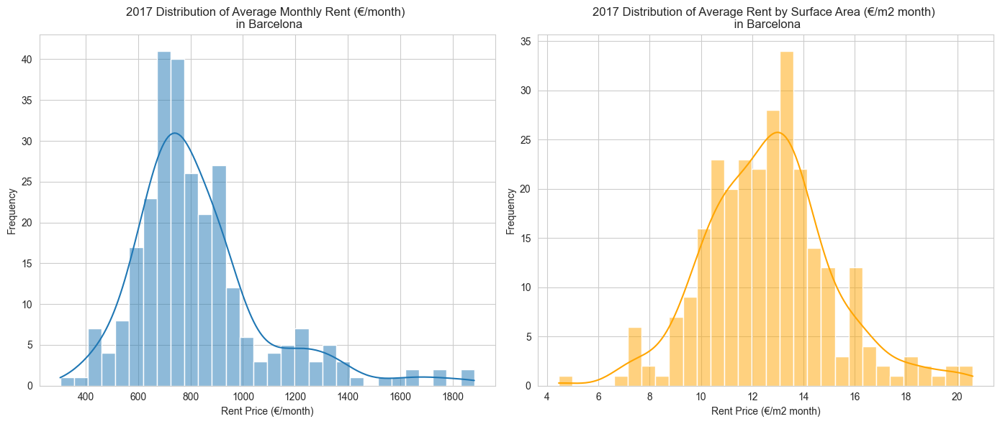

In [8]:
# Set the aesthetic style of the plots
sns.set_style('whitegrid')

# Create distribution plots for each category
plt.figure(figsize=(14, 6))

# Plot for 'Lloguer mitjà mensual (Euros/mes)'
plt.subplot(1, 2, 1)
sns.histplot(df_rent_prices_cleaned[df_rent_prices_cleaned['Lloguer_mitja'] == 'Lloguer mitjà mensual (Euros/mes)']['Preu'], kde=True, bins=30)
plt.title('2017 Distribution of Average Monthly Rent (€/month) \n in Barcelona')
plt.xlabel('Rent Price (€/month)')
plt.ylabel('Frequency')

# Plot for 'Lloguer mitjà per superfície (Euros/m2 mes)'
plt.subplot(1, 2, 2)
sns.histplot(df_rent_prices_cleaned[df_rent_prices_cleaned['Lloguer_mitja'] == 'Lloguer mitjà per superfície (Euros/m2 mes)']['Preu'], kde=True, color='orange', bins=30)
plt.title('2017 Distribution of Average Rent by Surface Area (€/m2 month) \n in Barcelona')
plt.xlabel('Rent Price (€/m2 month)')
plt.ylabel('Frequency')

# Display the plots
plt.tight_layout()
plt.show()


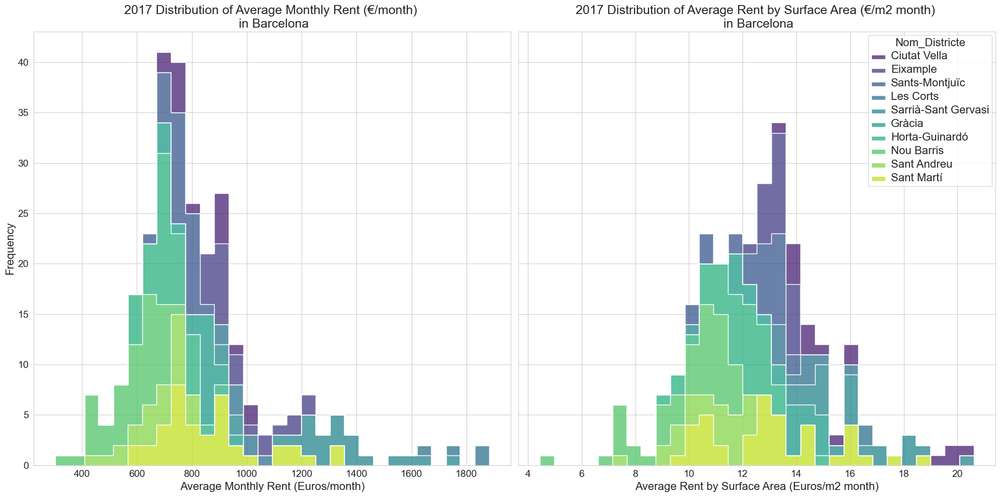

In [9]:
# Set up larger figure size for better visibility
plt.figure(figsize=(20, 10))

# Font size for titles and axis labels
title_fontsize = 18
axis_label_fontsize = 16
legend_fontsize = 16
axis_tick_fontsize = 14

# Plot distribution for average monthly rent by district
ax1 = plt.subplot(1, 2, 1)
sns.histplot(
    data=df_rent_prices_cleaned[df_rent_prices_cleaned['Lloguer_mitja'] == 'Lloguer mitjà mensual (Euros/mes)'],
    x='Preu', hue='Nom_Districte', element='step', palette='viridis', bins=30, multiple="stack"
)
plt.title('2017 Distribution of Average Monthly Rent (€/month) \n in Barcelona', fontsize=title_fontsize)
plt.xlabel('Average Monthly Rent (Euros/month)', fontsize=axis_label_fontsize)
plt.ylabel('Frequency', fontsize=axis_label_fontsize)
plt.xticks(fontsize=axis_tick_fontsize)
plt.yticks(fontsize=axis_tick_fontsize)

# Plot distribution for average rent by surface area by district
ax2 = plt.subplot(1, 2, 2, sharey=ax1)  # Share the y-axis with the first plot
sns.histplot(
    data=df_rent_prices_cleaned[df_rent_prices_cleaned['Lloguer_mitja'] == 'Lloguer mitjà per superfície (Euros/m2 mes)'],
    x='Preu', hue='Nom_Districte', element='step', palette='viridis', bins=30, multiple="stack"
)
plt.title('2017 Distribution of Average Rent by Surface Area (€/m2 month) \n in Barcelona', fontsize=title_fontsize)
plt.xlabel('Average Rent by Surface Area (Euros/m2 month)', fontsize=axis_label_fontsize)
plt.xticks(fontsize=axis_tick_fontsize)

# Remove y-axis label for the second subplot
ax2.yaxis.label.set_visible(False)

# Keep y-axis tick labels for the first plot only
ax2.tick_params(labelleft=False)

# Extract the legend and increase font size
legend = ax2.get_legend()
if legend:
    plt.setp(legend.get_texts(), fontsize=legend_fontsize)  # for legend text
    plt.setp(legend.get_title(), fontsize=legend_fontsize)  # for legend title

# Since we are plotting the same 'hue' categories (districts), we should only show the legend once.
# Remove the legend from the first subplot.
ax1.get_legend().remove()

plt.tight_layout()
plt.show()

In [10]:
# Calculate the summary statistics for 'Preu' by 'Lloguer_mitja' for each neighborhood
summary_stats_by_neighborhood = df_rent_prices_cleaned.groupby(['Nom_Barri', 'Lloguer_mitja'])['Preu'].describe()

# Display the DataFrame
summary_stats_by_neighborhood_full = summary_stats_by_neighborhood.reset_index()
summary_stats_by_neighborhood_full

,Nom_Barri,Lloguer_mitja,count,mean,std,min,25%,50%,75%,max
0,Can Baró,Lloguer mitjà mensual (Euros/mes),4.0,684.7900,32.422983,637.30,679.5625,695.840,701.0675,710.18
1,Can Baró,Lloguer mitjà per superfície (Euros/m2 mes),4.0,12.3925,0.366640,11.85,12.3300,12.545,12.6075,12.63
2,Can Peguera,Lloguer mitjà mensual (Euros/mes),1.0,407.2200,NaN,407.22,407.2200,407.220,407.2200,407.22
3,Can Peguera,Lloguer mitjà per superfície (Euros/m2 mes),1.0,11.6800,NaN,11.68,11.6800,11.680,11.6800,11.68
4,Canyelles,Lloguer mitjà mensual (Euros/mes),4.0,681.1925,19.357847,656.15,672.1625,683.560,692.5900,701.50
...,...,...,...,...,...,...,...,...,...,...
135,les Corts,Lloguer mitjà per superfície (Euros/m2 mes),4.0,14.2925,0.485000,13.63,14.0800,14.440,14.6525,14.66
136,les Roquetes,Lloguer mitjà mensual (Euros/mes),4.0,534.0050,33.390632,504.31,505.5550,533.265,561.7150,565.18
137,les Roquetes,Lloguer mitjà per superfície (Euros/m2 mes),4.0,10.1500,0.593914,9.41,9.9350,10.165,10.3800,10.86
138,les Tres Torres,Lloguer mitjà mensual (Euros/mes),4.0,1627.2025,101.613754,1516.52,1570.5275,1617.645,1674.3200,1757.00


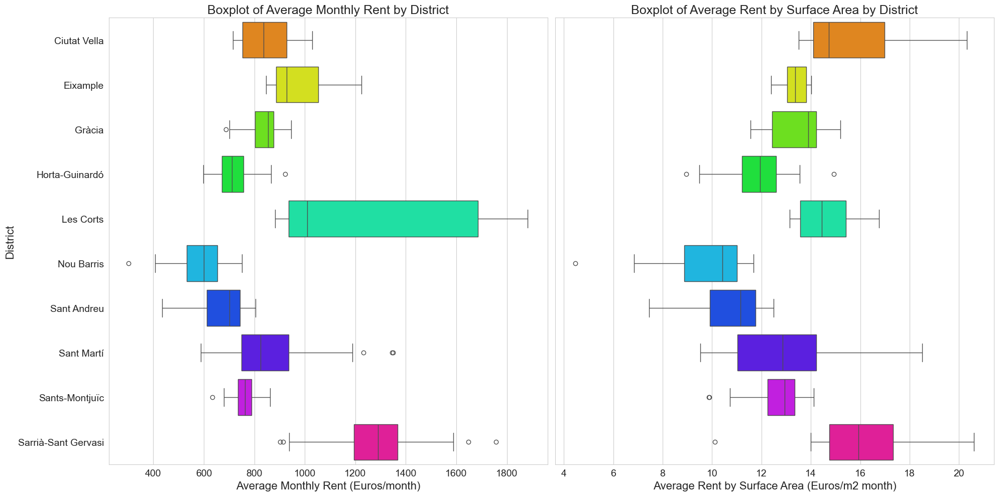

In [11]:
title_fontsize = 18
axis_label_fontsize = 16
legend_fontsize = 16
axis_tick_fontsize = 14

# Set the size of the entire figure
plt.figure(figsize=(20, 10))

# Set a consistent color palette for districts
palette = sns.color_palette("hsv", n_colors=len(df_rent_prices_cleaned['Nom_Districte'].unique()))

# Get the unique districts in the same order for both plots
district_order = df_rent_prices_cleaned['Nom_Districte'].sort_values().unique()

# First subplot for average monthly rent by district
ax1 = plt.subplot(1, 2, 1)
sns.boxplot(
    x='Preu',
    y='Nom_Districte',
    data=df_rent_prices_cleaned[df_rent_prices_cleaned['Lloguer_mitja'] == 'Lloguer mitjà mensual (Euros/mes)'],
    orient='h',
    palette=palette,
    order=district_order
)
ax1.set_title('Boxplot of Average Monthly Rent by District', fontsize=title_fontsize)
ax1.set_xlabel('Average Monthly Rent (Euros/month)', fontsize=axis_label_fontsize)
ax1.set_ylabel('District', fontsize=axis_label_fontsize)
ax1.tick_params(labelsize=axis_tick_fontsize)

# Second subplot for average rent by surface area by district
ax2 = plt.subplot(1, 2, 2, sharey=ax1)
sns.boxplot(
    x='Preu',
    y='Nom_Districte',
    data=df_rent_prices_cleaned[df_rent_prices_cleaned['Lloguer_mitja'] == 'Lloguer mitjà per superfície (Euros/m2 mes)'],
    orient='h',
    palette=palette,
    order=district_order
)
ax2.set_title('Boxplot of Average Rent by Surface Area by District', fontsize=title_fontsize)
ax2.set_xlabel('Average Rent by Surface Area (Euros/m2 month)', fontsize=axis_label_fontsize)
# Remove the y-axis labels for the second plot to avoid redundancy
ax2.set_ylabel('')
ax2.tick_params(labelsize=axis_tick_fontsize)
plt.setp(ax2.get_yticklabels(), visible=False)  # Hide the y-axis labels on the second subplot

plt.tight_layout()
plt.show()


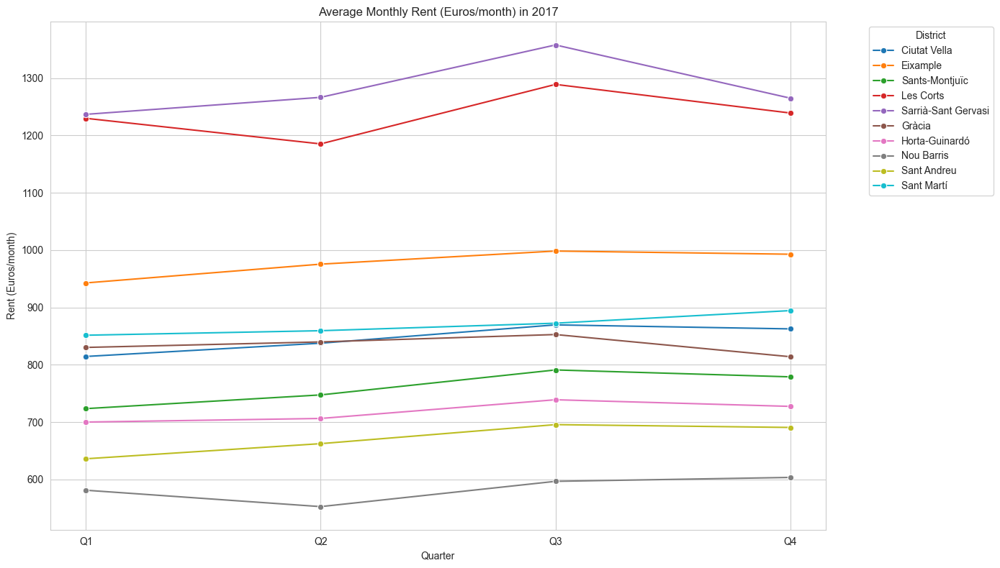

In [12]:
# Plot the evolution of rent prices
plt.figure(figsize=(14, 8))

sns.lineplot(
    data=df_rent_prices_cleaned[df_rent_prices_cleaned['Lloguer_mitja'] == 'Lloguer mitjà mensual (Euros/mes)'],
    x='Trimestre', y='Preu', hue='Nom_Districte',
    marker='o',
    ci=None
)

plt.title('Average Monthly Rent (Euros/month) in 2017')
plt.xlabel('Quarter')
plt.ylabel('Rent (Euros/month)')
plt.xticks([1, 2, 3, 4], ['Q1', 'Q2', 'Q3', 'Q4'])
plt.legend(title='District', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

plt.show()

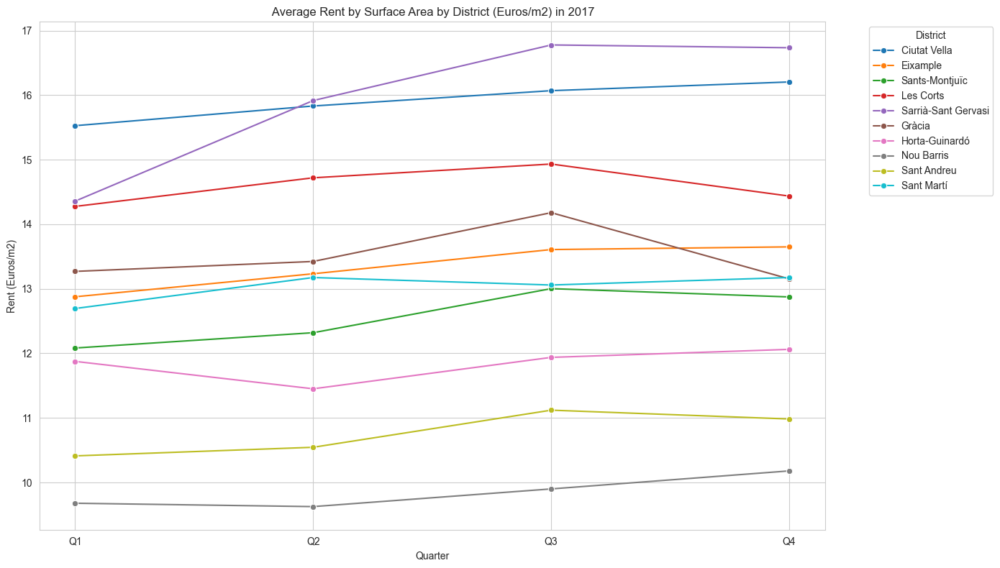

In [13]:
# Plot the evolution of rent prices
plt.figure(figsize=(14, 8))

sns.lineplot(
    data=df_rent_prices_cleaned[df_rent_prices_cleaned['Lloguer_mitja'] == 'Lloguer mitjà per superfície (Euros/m2 mes)'],
    x='Trimestre', y='Preu', hue='Nom_Districte',
    marker='o',
    ci=None
)

plt.title(' Average Rent by Surface Area by District (Euros/m2) in 2017')
plt.xlabel('Quarter')
plt.ylabel('Rent (Euros/m2)')
plt.xticks([1, 2, 3, 4], ['Q1', 'Q2', 'Q3', 'Q4'])
plt.legend(title='District', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

plt.show()

<div style="background-color:#F5F5F5; border-left: 5px solid black; padding: 0.8em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">2.3 Preliminary Analysis of the Rent Prices Data</h4>      
</div>

<div style="background-color:#F5F5F5; padding: 0.8em; padding-left: 2em; color: black;">

**Variability in Rent Prices:**

The district of Les Corts has the highest average monthly rent, with a mean of €1235.72, and it also displays the widest range in rent prices, evidenced by a standard deviation of €412.36. Nou Barris is the district with the lowest average monthly rent at €583.03 and also records the lowest average rent per surface area, with a mean of €9.84 per square meter per month.

**Comparison:**

Districts like Ciutat Vella and Eixample have relatively high average rents per surface area, which could suggest that smaller apartments in these areas come with a premium compared to larger ones. The average rent per square meter does not vary as much as the total monthly rent, indicating that apartment size may be a significant factor in the total rent price differences among districts.
    
**High-End Districts:**

Sarrià-Sant Gervasi stands out with the highest average rent prices, both monthly and per square meter, marking it as one of the priciest districts in Barcelona for residents.
    
**Affordability and Options:**

Horta-Guinardó offers a significant number of rental options (40 entries for both rent types) with a lower average monthly rent, suggesting a balance between affordability and availability. Nou Barris and Horta-Guinardó show less variability in rent per square meter, indicating more uniform pricing within these districts compared to others.
    
**Middle Range Options:**

Gràcia and Sant Martí offer moderate average rents and a moderate number of listings, which might appeal to renters seeking a middle ground in terms of pricing and options.
    
**Outliers:**

Outliers can be easily identified from the box plot, although they are few and for the purpose of this analysis, they will not be removed.

<div style="background-color:#F5F5F5; border-left: 5px solid black; padding: 0.8em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">2.4 Let's Map 2017 Rent Prices in Barcelona</h4>      
</div>

<div style="background-color:#F5F5F5; padding-left: 1.5em; color: black;">
    - A very important step in analyzing the data is to visualize and understand the physical location where this data is coming from so let's create and map the rent prices data using folium
</div>

In [14]:
# Separate the data into two categories: average monthly rent and average price per square meter
average_monthly_rent_df = df_rent_prices_cleaned[
    df_rent_prices_cleaned['Lloguer_mitja'] == 'Lloguer mitjà mensual (Euros/mes)']

average_price_per_sqm_df = df_rent_prices_cleaned[
   df_rent_prices_cleaned['Lloguer_mitja'] == 'Lloguer mitjà per superfície (Euros/m2 mes)']

# Aggregate the data by district to get the average price for each category
average_monthly_rent_by_neighborhood = average_monthly_rent_df.groupby('Nom_Barri')['Preu'].mean().reset_index()
average_price_per_sqm_by_neighborhood = average_price_per_sqm_df.groupby('Nom_Barri')['Preu'].mean().reset_index()


<div style="background-color:#F5F5F5; padding-left: 1.5em; color: black;">

**For Plotting Maps Geo Dataset containing Neighborhoods Polygons of Barcelona is used**

Data/BarcelonaCiutat_Barris.csv

Source:https://opendata-ajuntament.barcelona.cat/data/es/dataset/20170706-districtes-barris/resource/b21fa550-56ea-4f4c-9adc-b8009381896e?inner_spa

In [15]:
barri_geo_df = pd.read_csv("Data/BarcelonaCiutat_Barris.csv")

barri_geo_df['geometry'] = barri_geo_df['geometria_wgs84'].apply(wkt.loads)
barri_geo_df = gpd.GeoDataFrame(barri_geo_df, crs='epsg:4326')

barri_geo_df.rename(columns={'codi_barri': 'Codi_Barri'}, inplace=True)
barri_geo_df.rename(columns={'nom_barri': 'Nom_Barri'}, inplace=True)

# Merge the GeoDataFrame with the average monthly rent by neighborhood
choropleth_data1 = barri_geo_df.merge(average_monthly_rent_by_neighborhood, left_on='Nom_Barri', right_on='Nom_Barri', how='left')
choropleth_data2 = barri_geo_df.merge(average_price_per_sqm_by_neighborhood, left_on='Nom_Barri', right_on='Nom_Barri', how='left')

# Drop any NA values that might have resulted from the merge (in case there are neighborhoods without rent data)
choropleth_data1 = choropleth_data1.dropna(subset=['Preu'])
choropleth_data2 = choropleth_data2.dropna(subset=['Preu'])

# Round the 'Preu' values to 2 decimal places for the tooltip
choropleth_data1['Preu'] = choropleth_data1['Preu'].round(2)
choropleth_data2['Preu'] = choropleth_data2['Preu'].round(2)

# Create a Dual Folium map centered around Barcelona
barcelona_coords = [41.42, 2.154]
dual_map = DualMap(location=barcelona_coords, tiles='CartoDB positron', zoom_start=11.77, zoom_control=False)

# Create a choropleth map using the merged GeoDataFrame
folium.Choropleth(
    geo_data=choropleth_data1,
    name='Choropleth',
    data=choropleth_data1,
    columns=['Nom_Barri', 'Preu'],
    key_on='feature.properties.Nom_Barri',
    fill_color='RdYlGn_r', 
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Average Monthly Rent (€)'
).add_to(dual_map.m1)

# Add hover functionality to display neighborhood name and price
style_function = lambda x: {'fillColor': '#ffffff', 'color':'#000000', 'fillOpacity': 0.1, 'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 'color':'#000000', 'fillOpacity': 0.50, 'weight': 0.1}

NIL1 = folium.features.GeoJson(
    data=choropleth_data1,
    style_function=style_function,
    control=False,
    highlight_function=highlight_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['Nom_Barri', 'Preu'],
        aliases=['Neighborhood: ', 'Average Montlhy Rent (€):'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
    )
)
dual_map.m1.add_child(NIL1)
dual_map.m1.keep_in_front(NIL1)

# Create a choropleth map using the merged GeoDataFrame
folium.Choropleth(
    geo_data=choropleth_data2,
    name='Choropleth',
    data=choropleth_data2,
    columns=['Nom_Barri', 'Preu'],
    key_on='feature.properties.Nom_Barri',
    fill_color='RdYlGn_r',  
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Average Rent by Surface (€/m2 month)'
).add_to(dual_map.m2)

# Add hover functionality to display neighborhood name and price
style_function = lambda x: {'fillColor': '#ffffff', 'color':'#000000', 'fillOpacity': 0.1, 'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 'color':'#000000', 'fillOpacity': 0.50, 'weight': 0.1}

NIL2 = folium.features.GeoJson(
    data=choropleth_data2,
    style_function=style_function,
    control=False,
    highlight_function=highlight_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['Nom_Barri', 'Preu'],
        aliases=['Neighborhood: ', 'Average Rent (€/m2 month):'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
    )
)
dual_map.m2.add_child(NIL2)
dual_map.m2.keep_in_front(NIL2)

# Display the map
print(bold_print("                                    2017 Average Monthly Rent (€/month) &\n                                       Rent by Surface (€/m2 month) \n                                       in Barcelona by Neighborhood"))

dual_map

                                    2017 Average Monthly Rent (€/month) &
                                       Rent by Surface (€/m2 month) 
                                       in Barcelona by Neighborhood


<div style="background-color:#F5F5F5; padding-left: 1.5em; color: black;">
- Next step is to select which dataset and which fields to use. For this study let's take the accident data set<br>
- First let's explore and pre process and clean the data.<br>
</div>

<div style="background-color:#F5F5F5; border-left: 5px solid black; padding: 0.8em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">3.1 Merge Accident Dataset with Rent Prices</h4>      
</div>

<div style="background-color:#F5F5F5; padding-left: 1.5em; color: black;">
 - Study will focus into summarizing and bringing the average noise levels per Neighborhood and District occurred in Barcelona in 2017.<br>
    - We will actually create two datasets since we have two pricing categories one is Average Rent Price per Month and the other one is Average price per m2
</div>

<div style="background-color:#F5F5F5; padding-left: 1.5em; color: black;">
    
 **First we need to process Noise Data**
   The noise data fields repesent the percentage of people exposed to different noise ranges in the different neighborhoods in order to get an estimated average value of noise level per neighborhood we will do the folowing:

1. **Calculating the Midpoint of a Noise Range**:
   If the range is specified (e.g., "40-45 dB"), the midpoint is the average of the lower and upper bounds of the range.
   $$
   \text{Midpoint} = \frac{\text{Lower Bound} + \text{Upper Bound}}{2}
   $$
   For open-ended ranges, we assign a reasonable value that represents the range adequately. For example:
   - For "<40 dB", we could use 35 dB as the midpoint.
   - For ">=80 dB", we could use 85 dB as the midpoint.

2. **Converting Percentages to Proportions**:
   The percentage of the population exposed to each noise level range is converted to a proportion.
   $$
   \text{Proportion} = \frac{\text{Percentage}}{100}
   $$

3. **Calculating Weighted Contributions**:
   Each noise level range's contribution to the average noise level is its midpoint multiplied by the proportion of the population exposed to that range.
   $$
   \text{Weighted Contribution} = \text{Midpoint} \times \text{Proportion}
   $$

4. **Summing Weighted Contributions for the Average Noise Level**:
   The estimated average noise level for each neighborhood is the sum of all weighted contributions.
   $$
   \text{Estimated Average Noise Level} = \sum(\text{Weighted Contributions})
   $$


In [16]:


# Correct the calculation of the estimated average noise level
def estimate_midpoint_corrected(range_str):
    # Handle the "<40 dB" and ">=80 dB" cases with plausible midpoints
    if range_str == '<40 dB':
        return 35  # Assume a midpoint of 35 dB for "<40 dB"
    elif range_str == '>=80 dB':
        return 80  # Assume a midpoint of 80 dB for ">=80 dB"
    else:
        # Calculate the midpoint for ranges like "40-45 dB"
        low, high = map(int, range_str.replace(' dB', '').split('-'))
        return (low + high) / 2
    
# Define a custom function to convert values to numeric if they are strings
def convert_to_numeric(value):
    if isinstance(value, str):
        return float(value.rstrip('%')) / 100
    return value

# Apply the corrected midpoint estimation
df_noise['Midpoint'] = df_noise['Rang_soroll'].apply(estimate_midpoint_corrected)

# Apply the custom function to the column
df_noise['Valor'] =  df_noise['Valor'].apply(convert_to_numeric)


# Calculate the weighted contributions again
df_noise['Weighted_Midpoint'] = df_noise['Midpoint'] * df_noise['Valor']

# Group by neighborhood to calculate the weighted average noise level
average_noise_df_corrected = df_noise.groupby(['Codi_Districte', 'Nom_Districte', 'Codi_Barri', 'Nom_Barri'])\
                                     .apply(lambda x: sum(x['Weighted_Midpoint']) / sum(x['Valor']))\
                                     .reset_index(name='Estimated_Average_Noise_Level')

# Merge this corrected data with the rent price dataset again
merged_noise_df = pd.merge(df_rent_prices_cleaned, average_noise_df_corrected, 
                               on=['Codi_Districte', 'Nom_Districte', 'Codi_Barri', 'Nom_Barri'],
                               how='left')

merged_noise_df.to_csv('merged_noise_df.csv', index=False)
merged_noise_df

,Any,Trimestre,Codi_Districte,Nom_Districte,Codi_Barri,Nom_Barri,Lloguer_mitja,Preu,Estimated_Average_Noise_Level
0,2017,1,1,Ciutat Vella,1,el Raval,Lloguer mitjà mensual (Euros/mes),734.99,40.476865
1,2017,1,1,Ciutat Vella,2,el Barri Gòtic,Lloguer mitjà mensual (Euros/mes),905.26,41.113000
2,2017,1,1,Ciutat Vella,3,la Barceloneta,Lloguer mitjà mensual (Euros/mes),722.78,40.952731
3,2017,1,1,Ciutat Vella,4,"Sant Pere, Santa Caterina i la Ribera",Lloguer mitjà mensual (Euros/mes),895.28,40.753288
4,2017,1,2,Eixample,5,el Fort Pienc,Lloguer mitjà mensual (Euros/mes),871.08,43.565173
...,...,...,...,...,...,...,...,...,...
541,2017,4,10,Sant Martí,69,Diagonal Mar i el Front Marítim del Poblenou,Lloguer mitjà per superfície (Euros/m2 mes),16.51,43.834587
542,2017,4,10,Sant Martí,70,el Besòs i el Maresme,Lloguer mitjà per superfície (Euros/m2 mes),10.40,41.024394
543,2017,4,10,Sant Martí,71,Provençals del Poblenou,Lloguer mitjà per superfície (Euros/m2 mes),12.66,44.239663
544,2017,4,10,Sant Martí,72,Sant Martí de Provençals,Lloguer mitjà per superfície (Euros/m2 mes),10.83,41.471577


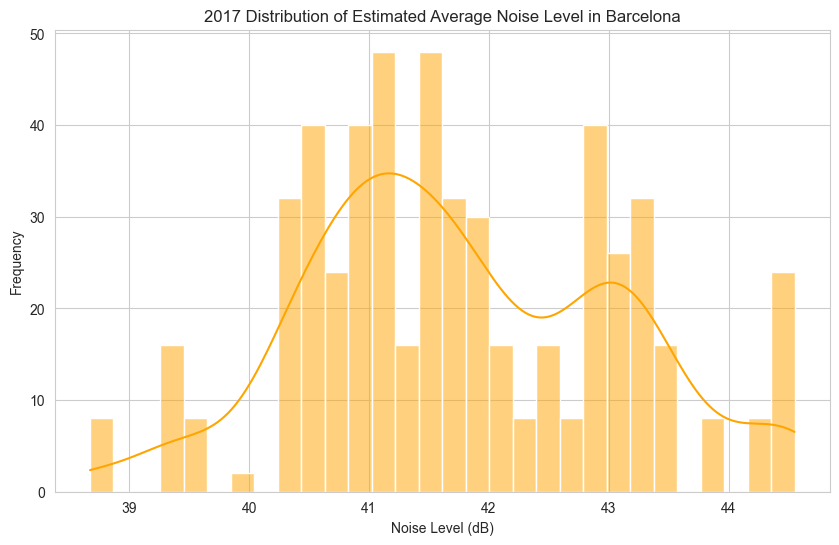

In [17]:
# Set the aesthetic style of the plots
sns.set_style("whitegrid")

# Create a figure for the plot
plt.figure(figsize=(10, 6))

# Distribution of 'Estimated_Average_Noise_Level'
sns.histplot(merged_noise_df['Estimated_Average_Noise_Level'], bins=30, kde=True,color="orange")
plt.title('2017 Distribution of Estimated Average Noise Level in Barcelona')
plt.xlabel('Noise Level (dB)')
plt.ylabel('Frequency')

plt.show()

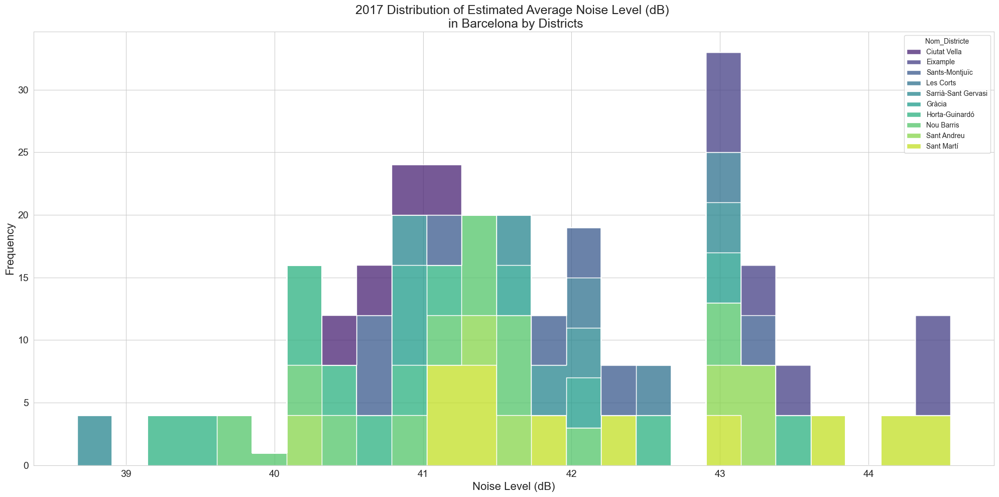

In [18]:
# Set up larger figure size for better visibility
plt.figure(figsize=(20, 10))

# Font size for titles and axis labels
title_fontsize = 18
axis_label_fontsize = 16
legend_fontsize = 16
axis_tick_fontsize = 14

# Plot distribution for average monthly rent by district
ax1 = plt.subplot(1, 1, 1)
sns.histplot(
    data=merged_noise_df[merged_noise_df['Lloguer_mitja'] == 'Lloguer mitjà mensual (Euros/mes)'],
    x='Estimated_Average_Noise_Level', hue='Nom_Districte', element='step', palette='viridis', bins=25, multiple="stack"
)
plt.title('2017 Distribution of Estimated Average Noise Level (dB) \n in Barcelona by Districts', fontsize=title_fontsize)
plt.xlabel('Noise Level (dB)', fontsize=axis_label_fontsize)
plt.ylabel('Frequency', fontsize=axis_label_fontsize)
plt.xticks(fontsize=axis_tick_fontsize)
plt.yticks(fontsize=axis_tick_fontsize)

plt.tight_layout()
plt.show()

In [19]:


# Merge the counts with the neighborhoods GeoDataFrame
choropleth_data_noise = barri_geo_df.merge(merged_noise_df, left_on='Codi_Barri', right_on='Codi_Barri', how='left')

choropleth_data_noise['Estimated_Average_Noise_Level'] = choropleth_data_noise['Estimated_Average_Noise_Level'].round(2)

barcelona_coords = [41.40, 2.19]

# Create a new map for the choropleth
map_noise_cloropeth= folium.Map(location=barcelona_coords, tiles='CartoDB positron', zoom_start=12)

# Define the choropleth map
folium.Choropleth(
    geo_data=choropleth_data_noise,
    name='Choropleth',
    data=choropleth_data_noise,
    columns=['Codi_Barri', 'Estimated_Average_Noise_Level'],
    key_on='feature.properties.Codi_Barri',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Estimated_Average_Noise_Level',
    smooth_factor=0,
    Highlight=True,
    line_color='#0000', 
    show=False,
    overlay=True,
    nan_fill_color='transparent'
).add_to(map_noise_cloropeth)

style_function = lambda x: {'fillColor': '#ffffff', 'color':'#000000', 'fillOpacity': 0.1, 'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 'color':'#000000', 'fillOpacity': 0.50, 'weight': 0.1}

NIL2 = folium.features.GeoJson(
    data=choropleth_data_noise,
    style_function=style_function,
    control=False,
    highlight_function=highlight_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['Nom_Barri_x', 'Estimated_Average_Noise_Level'],
        aliases=['Neighborhood: ', 'Noise Levels:'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
    )
)
map_noise_cloropeth.add_child(NIL2)
map_noise_cloropeth.keep_in_front(NIL2)

print(bold_print("                                          2017 Estimated Average Noise Levels (dB)\n                                               in Barcelona by Neighborhood"))

map_noise_cloropeth


                                          2017 Estimated Average Noise Levels (dB)
                                               in Barcelona by Neighborhood


<div style="background-color:#F5F5F5; border-left: 5px solid black; padding: 0.8em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">4 PCA</h4>      
</div>

<div style="background-color:#F5F5F5; padding-left: 1.5em; color: black;">
 - For PCA analysis, we will need meaningful variables. The two datasets we merged do not correlate well since traffic accident data cannot be easily related to rent prices. At most, there could be some relationship to noise levels in the neighborhoods, but many other factors would need to be considered for a thorough study.
</div>

In [20]:
# Remove rows where "Lloguer_mitja" refers to "Lloguer mitjà per superfície (Euros/m2 mes)"
merged_noise_df = merged_noise_df[merged_noise_df['Lloguer_mitja'] != 'Lloguer mitjà per superfície (Euros/m2 mes)']
merged_noise_df

,Any,Trimestre,Codi_Districte,Nom_Districte,Codi_Barri,Nom_Barri,Lloguer_mitja,Preu,Estimated_Average_Noise_Level
0,2017,1,1,Ciutat Vella,1,el Raval,Lloguer mitjà mensual (Euros/mes),734.99,40.476865
1,2017,1,1,Ciutat Vella,2,el Barri Gòtic,Lloguer mitjà mensual (Euros/mes),905.26,41.113000
2,2017,1,1,Ciutat Vella,3,la Barceloneta,Lloguer mitjà mensual (Euros/mes),722.78,40.952731
3,2017,1,1,Ciutat Vella,4,"Sant Pere, Santa Caterina i la Ribera",Lloguer mitjà mensual (Euros/mes),895.28,40.753288
4,2017,1,2,Eixample,5,el Fort Pienc,Lloguer mitjà mensual (Euros/mes),871.08,43.565173
...,...,...,...,...,...,...,...,...,...
268,2017,4,10,Sant Martí,69,Diagonal Mar i el Front Marítim del Poblenou,Lloguer mitjà mensual (Euros/mes),1233.01,43.834587
269,2017,4,10,Sant Martí,70,el Besòs i el Maresme,Lloguer mitjà mensual (Euros/mes),621.32,41.024394
270,2017,4,10,Sant Martí,71,Provençals del Poblenou,Lloguer mitjà mensual (Euros/mes),864.09,44.239663
271,2017,4,10,Sant Martí,72,Sant Martí de Provençals,Lloguer mitjà mensual (Euros/mes),790.58,41.471577


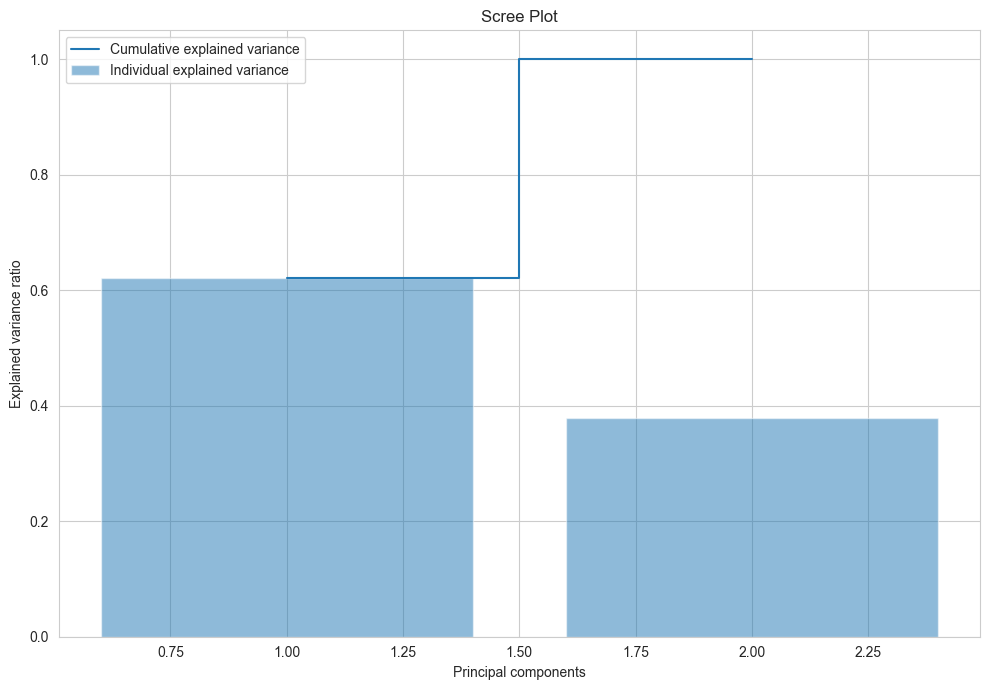

In [21]:
from sklearn.preprocessing import StandardScaler
# Re-apply the standardization and PCA as previous steps
scaler = StandardScaler()
numeric_cols = merged_noise_df.select_dtypes(include=['float64', 'int64']).columns.drop(['Any', 'Trimestre','Codi_Barri','Codi_Districte'])
numeric_data = merged_noise_df[numeric_cols]
numeric_data_scaled = scaler.fit_transform(numeric_data)

pca = PCA(n_components=0.95)
principal_components = pca.fit_transform(numeric_data_scaled)

# calculation for cumulative explained variance
cumulative_explained_variance = pca.explained_variance_ratio_.cumsum()

# Scree Plot with cumulative explained variance
plt.figure(figsize=(10, 7))
plt.bar(range(1, len(pca.explained_variance_ratio_)+1), pca.explained_variance_ratio_, alpha=0.5, align='center', label='Individual explained variance')
plt.step(range(1, len(cumulative_explained_variance)+1), cumulative_explained_variance, where='mid', label='Cumulative explained variance')
plt.title('Scree Plot')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal components')
plt.legend(loc='best')
plt.tight_layout()

# Display scree plot
plt.show()



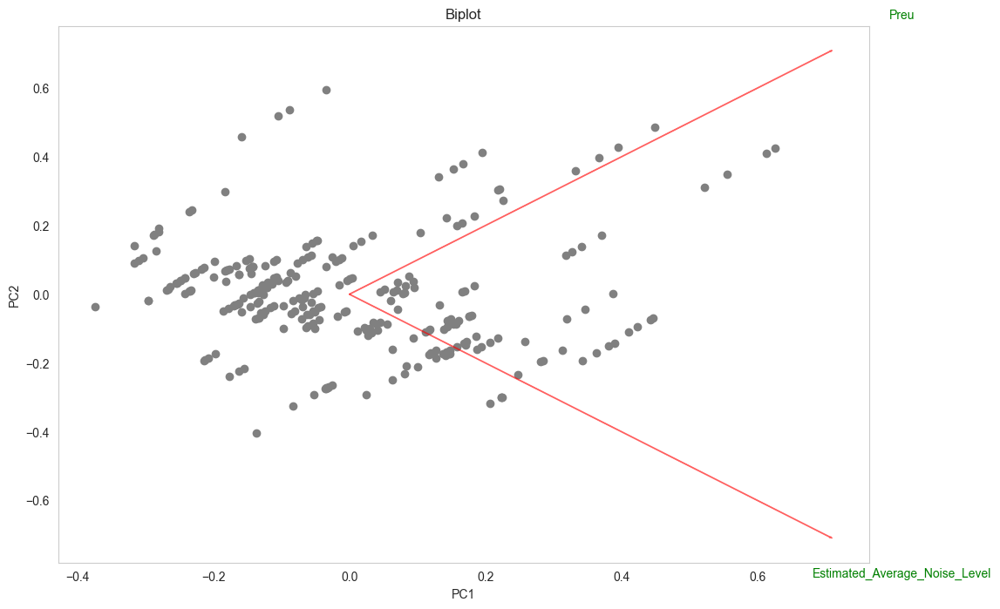

In [22]:
import numpy as np

def biplot(score,coeff,labels=None):
    xs = score[:,0]
    ys = score[:,1]
    n = coeff.shape[0]
    scalex = 1.0/(xs.max() - xs.min())
    scaley = 1.0/(ys.max() - ys.min())
    
    plt.scatter(xs * scalex,ys * scaley, c = 'grey')
    
    for i in range(n):
        # Arrows project features (the variable axes) as vectors onto the principal components
        plt.arrow(0, 0, coeff[i,0], coeff[i,1],color = 'r',alpha = 0.5)
        if labels is None:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, "Var"+str(i+1), color = 'g', ha = 'center', va = 'center')
        else:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, labels[i], color = 'g', ha = 'center', va = 'center')
    
    plt.xlabel("PC{}".format(1))
    plt.ylabel("PC{}".format(2))
    plt.grid()

# Call the function. Use only the 2 principal components.
plt.figure(figsize=(12, 8))
plt.title('Biplot')
# Now let's redefine the biplot function and generate the biplot
biplot(principal_components[:,0:2], np.transpose(pca.components_[0:2, :]), labels=numeric_data.columns)
plt.show()

<div style="background-color:#F5F5F5; padding-left: 1.5em; color: black;">

- The grey dots represent the neighborhoods projected onto the first two principal components.
- The red arrows represent the original variables (Preu and Estimated_Average_Noise_Level). The direction and length of the arrows indicate how each variable influences the principal components.

From the biplot, you can observe:

- Both variables seem to contribute similarly to the first principal component, as indicated by the arrows pointing roughly in the same direction.
- The second principal component captures variation orthogonal to the first, as seen by the difference in direction of the arrows.

In [23]:
# Calculate the correlation coefficient between 'Preu' and 'Estimated_Average_Noise_Level'
correlation = merged_noise_df[['Preu', 'Estimated_Average_Noise_Level']].corr()

correlation

,Preu,Estimated_Average_Noise_Level
Preu,1.000000,0.241251
Estimated_Average_Noise_Level,0.241251,1.000000


<div style="background-color:#F5F5F5; border-left: 5px solid black; padding: 0.8em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">5 Conclusions</h4>      
</div>

<div style="background-color:#F5F5F5; padding-left: 1.5em; color: black;">

**Results:**
The scree plot shows the variance explained by each of the principal components. In our case, since there were only two features ('Preu' and 'Estimated_Average_Noise_Level') to start with, there are only two principal components.

The first principal component explains a significant portion of the variance in the data set. The exact percentage can be noted from the height of the first bar in the scree plot. This indicates that this principal component captures most of the information that was spread out over the original two features.

The second principal component, although explaining less variance than the first, still holds some level of information. Since we only started with two features, the second principal component will capture the remaining variance.

The cumulative explained variance line shows that by including both principal components, we retain the entirety of the information present in the original dataset.

**Interpretation:**

The dominance of the first principal component suggests that there is a strong pattern in the dataset where 'Preu' and 'Estimated_Average_Noise_Level' vary together to some extent. If the first principal component explains a large proportion of the variance (close to 100%), this would imply a strong linear relationship between the two original variables.

Given that the two original features are 'Preu' (price) and 'Estimated_Average_Noise_Level', the first principal component could be interpreted as an index of 'cost of living' or 'rental desirability', assuming that noise level is an important factor in rental prices.

The second principal component would then capture variations in the data that are orthogonal (independent) to the first component. If the first component represents a 'cost of living' index, the second could represent variations that are independent of this index, perhaps related to aspects of the neighborhood that are not captured by price and noise level alone.

Despite the PCA suggesting that these two variables contribute similarly to the first principal component, the actual linear relationship between them is not strong, according to the correlation coefficient. This result suggests that other factors may be influencing the variation captured by the first principal component, or that the relationship between rent price and noise level is not linear and may be more complex.

These two datasets together do not show a strong correlation that would allow for further analysis of the increase in rental prices in Barcelona during 2017. Although there might be some relationship between noise levels and neighborhood rental prices, many other factors must be taken into account to perform a thorough study.

<div style="background-color:#F5F5F5; border-left: 5px solid black; padding: 0.8em; color: black;">
    <h4 style="margin-top: 0.3em; margin-bottom: 0.3em;">6 Complementary Analysis in Traffic Accident Data</h4>      
</div>

In [24]:

#Drop unknown values
df_accidents = df_accidents[df_accidents.ne('Desconegut').all(axis=1)]
# Drop rows with any NaN values
cleaned_accidents_df = df_accidents.dropna()

# Assuming df is your DataFrame
cleaned_accidents_df.rename(columns={'Codi_barri': 'Codi_Barri'}, inplace=True)
cleaned_accidents_df.rename(columns={'Nom_barri': 'Nom_Barri'}, inplace=True)
cleaned_accidents_df.rename(columns={'Codi_districte': 'Codi_Districte'}, inplace=True)
cleaned_accidents_df.rename(columns={'Nom_districte': 'Nom_Districte'}, inplace=True)

# Define a function to map the month to a quarter
def map_month_to_quarter(month):
    if 1 <= month <= 3:
        return 1
    elif 4 <= month <= 6:
        return 2
    elif 7 <= month <= 9:
        return 3
    elif 10 <= month <= 12:
        return 4

# Apply the function to the 'Mes_any' column to create the 'Trimestre' column
cleaned_accidents_df['Trimestre'] = cleaned_accidents_df['Mes_any'].apply(map_month_to_quarter)

# Now group by the 'Trimestre', 'Codi_districte', 'Nom_districte', 'Codi_barri', and 'Nom_barri'
# and count the number of accidents
accidents_summary_df = cleaned_accidents_df.groupby(
    ['Codi_Barri','Nom_Barri','Codi_Districte', 'Nom_Districte', 'Trimestre']
).size().reset_index(name='Number_of_accidents')

accidents_summary_ll_df = cleaned_accidents_df.groupby(
    ['Codi_Barri','Nom_Barri','Codi_Districte', 'Nom_Districte', 'Trimestre','Latitud','Longitud']
).size().reset_index(name='Number_of_accidents')

accidents_summary_df

,Codi_Barri,Nom_Barri,Codi_Districte,Nom_Districte,Trimestre,Number_of_accidents
0,1,el Raval,1,Ciutat Vella,1,60
1,1,el Raval,1,Ciutat Vella,2,33
2,1,el Raval,1,Ciutat Vella,3,37
3,1,el Raval,1,Ciutat Vella,4,31
4,2,el Barri Gòtic,1,Ciutat Vella,1,30
...,...,...,...,...,...,...
284,72,Sant Martí de Provençals,10,Sant Martí,4,16
285,73,la Verneda i la Pau,10,Sant Martí,1,15
286,73,la Verneda i la Pau,10,Sant Martí,2,20
287,73,la Verneda i la Pau,10,Sant Martí,3,20


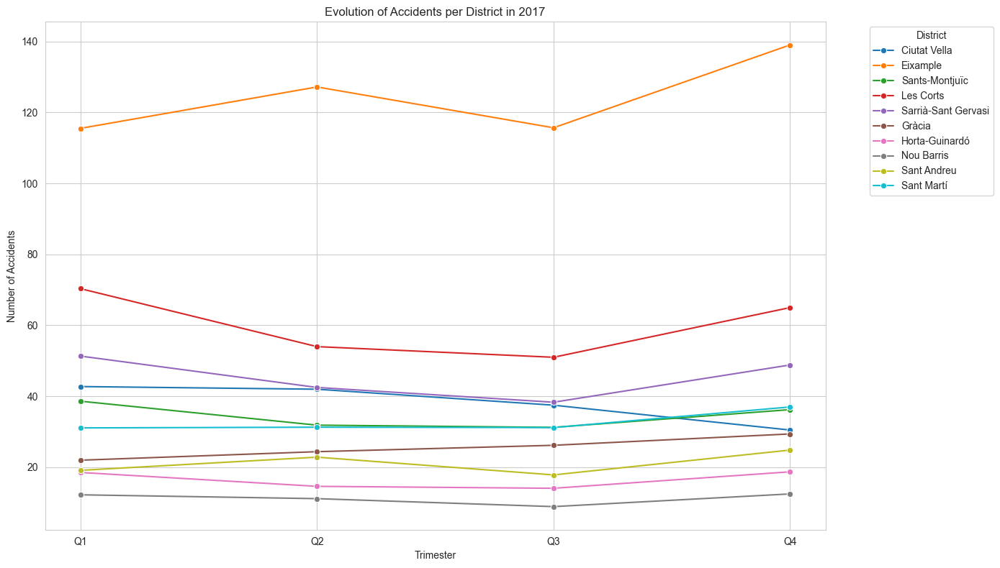

In [25]:
# Plot the evolution of accidents per district
plt.figure(figsize=(14, 8))

sns.lineplot(
    data=accidents_summary_df,
    x='Trimestre', y='Number_of_accidents', hue='Nom_Districte',
    marker='o',
    ci=None
)

plt.title('Evolution of Accidents per District in 2017')
plt.xlabel('Trimester')
plt.ylabel('Number of Accidents')
plt.xticks([1, 2, 3, 4], ['Q1', 'Q2', 'Q3', 'Q4'])
plt.legend(title='District', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

plt.show()

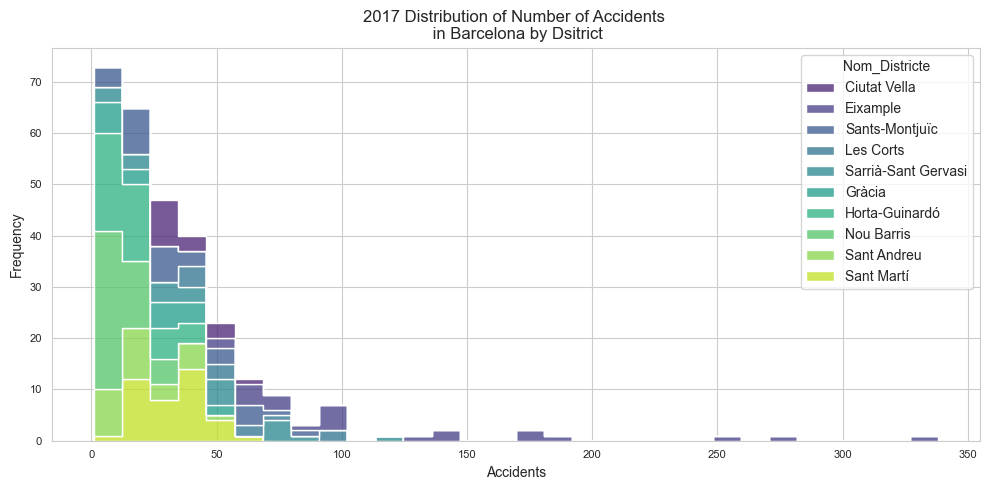

In [26]:
# Set up larger figure size for better visibility
plt.figure(figsize=(10, 5))

# Font size for titles and axis labels
title_fontsize = 12
axis_label_fontsize = 10
legend_fontsize = 10
axis_tick_fontsize = 8

# Plot distribution for average monthly rent by district

sns.histplot(
    data=accidents_summary_df,
    x='Number_of_accidents', hue='Nom_Districte', element='step', palette='viridis', bins=30, multiple="stack"
)
plt.title('2017 Distribution of Number of Accidents \n in Barcelona by Dsitrict', fontsize=title_fontsize)
plt.xlabel('Accidents', fontsize=axis_label_fontsize)
plt.ylabel('Frequency', fontsize=axis_label_fontsize)
plt.xticks(fontsize=axis_tick_fontsize)
plt.yticks(fontsize=axis_tick_fontsize)


plt.tight_layout()
plt.show()

In [27]:

# Aggregate the accident data by neighborhood to calculate the number of accidents per neighborhood
accidents_count_by_neighborhood = accidents_summary_df.groupby('Codi_Barri').sum().reset_index()

# Merge the counts with the neighborhoods GeoDataFrame
choropleth_data = barri_geo_df.merge(accidents_count_by_neighborhood, left_on='Codi_Barri', right_on='Codi_Barri', how='left')

barcelona_coords = [41.386, 2.19]

# Create a new map for the choropleth
map_accidents_cloropeth= folium.Map(location=barcelona_coords, tiles='CartoDB positron', zoom_start=11.5)

# Define the choropleth map
folium.Choropleth(
    geo_data=choropleth_data,
    name='Choropleth',
    data=choropleth_data,
    columns=['Codi_Barri', 'Number_of_accidents'],
    key_on='feature.properties.Codi_Barri',
    fill_color='YlOrRd',  # Yellow-orange-red color scale
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Accident Count',
    smooth_factor=0,
    Highlight=True,
    line_color='#0000',  # Use a transparent line color for borders
    show=False,
    overlay=True,
    nan_fill_color='transparent'
).add_to(map_accidents_cloropeth)

style_function = lambda x: {'fillColor': '#ffffff', 'color':'#000000', 'fillOpacity': 0.1, 'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 'color':'#000000', 'fillOpacity': 0.50, 'weight': 0.1}

NIL2 = folium.features.GeoJson(
    data=choropleth_data,
    style_function=style_function,
    control=False,
    highlight_function=highlight_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['Nom_Barri', 'Number_of_accidents'],
        aliases=['Neighborhood: ', 'Total accidents::'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
    )
)
map_accidents_cloropeth.add_child(NIL2)
map_accidents_cloropeth.keep_in_front(NIL2)




print(bold_print("                                          2017 Total Car Accidents\n                                       in Barcelona by Neighborhood"))

map_accidents_cloropeth

                                          2017 Total Car Accidents
                                       in Barcelona by Neighborhood


In [28]:
# Function to change the style of the GeoJson for neighborhoods
def style_function(feature):
    return {
        'fillColor': 'transparent',  # Light orange fill
        'color': 'black',        # Black borders
        'weight': 1,             # Border line weight
        'dashArray': '5, 5'      # Dashed borders pattern
    }

# Aggregate the accident data by neighborhood to calculate the number of accidents per neighborhood
accidents_count_by_neighborhood = accidents_summary_df.groupby('Codi_Barri').sum().reset_index()

# Merge the counts with the neighborhoods GeoDataFrame
barri_data = barri_geo_df.merge(accidents_count_by_neighborhood, left_on='Codi_Barri', right_on='Codi_Barri', how='left')

barcelona_coords = [41.395, 2.19]


locked_zoom_level = 12
# Create a new map for the choropleth
map_accidents_1= folium.Map(location=barcelona_coords, tiles='CartoDB positron', zoom_start=locked_zoom_level, max_zoom=locked_zoom_level, min_zoom=locked_zoom_level)

# Add the neighborhood polygons to the map with the defined style
folium.GeoJson(
    barri_geo_df,
    style_function=style_function
).add_to(map_accidents_1)


# Create a list of latitude and longitude coordinates from your accident data
heat_data = [[row['Latitud'], row['Longitud']] for index, row in accidents_summary_ll_df.iterrows()]

# Create a HeatMap layer and add it to the map
HeatMap(heat_data, min_zoom=12,max_zoom=12,radius=12).add_to(map_accidents_1)

NIL1 = folium.features.GeoJson(
    data=barri_data,
    style_function=style_function,
    control=False,
    highlight_function=highlight_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['Nom_Barri', 'Number_of_accidents'],
        aliases=['Neighborhood: ', 'Total accidents::'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
    )
)
map_accidents_1.add_child(NIL1)
map_accidents_1.keep_in_front(NIL1)


print(bold_print("                                          2017 Total Car Accidents Heat Map\n                                            in Barcelona by Neighborhood"))
map_accidents_1


                                          2017 Total Car Accidents Heat Map
                                            in Barcelona by Neighborhood


<div style="background-color:#F5F5F5; padding-left: 1.5em; color: black;">
 
**Analysis**
    
- The distribution and maps clearly illustrate the locations with the most accidents, which, as expected, occur on the busier roads.
    
- Additional analysis of this dataset alone could range from examining accident trends to clustering to determine hot spots.
